# SMS Spam Collection

### Task:
The primary task involves creating an AI model capable of distinguishing between spam and non-spam (ham) SMS messages. By utilizing the SMS Spam Collection Dataset, our goal is to develop, train, and evaluate machine learning models tailored for this specific purpose.

This endeavor encompasses crucial stages, starting with exploring and understanding the dataset. Cleaning the data by handling missing values, removing unnecessary elements, and executing text preprocessing tasks will be essential for model training.

Subsequently, we'll transform the text data into numerical features suitable for model training using techniques like TF-IDF or CountVectorizer.

The heart of this task lies in constructing machine learning models like Logistic Regression, Naive Bayes, SVM, Random Forest, and Gradient Boosting for accurate classification.

We'll rigorously evaluate these models using metrics such as accuracy, precision, recall, and F1-score, aiming to select the most efficient one.

### Problem Statement:
Develop an automated system that can accurately classify incoming SMS messages as either spam or legitimate (ham) based on their content.

### Research Question
What impact do text pre-processing methods have on the performance of SMS spam classification models with SMS spam collection Dataset?

## Install

In [79]:
pip install lime # install LIME

## Imports

In [80]:
# Standard library imports
import pandas as pd
import numpy as np
import re
import nltk
from nltk.corpus import stopwords  # Importing NLTK's stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

# Download NLTK stopwords (if not already downloaded)
nltk.download('stopwords')

# Download WordNet data for lemmatization
nltk.download('wordnet')

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Scikit-learn imports
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.metrics import classification_report, f1_score, confusion_matrix
from sklearn.model_selection import cross_val_predict
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier

# LIME imports
import lime
import lime.lime_text
from lime.lime_text import LimeTextExplainer

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


## Plotting functions

In [81]:
def plot_message_length(data_original, data_cleaned, preprocessing_step):
  """
  Plot a comparison of message lengths before and after a specific preprocessing step.

  Args:
  - data_original (DataFrame): DataFrame containing original message data
  - data_cleaned (DataFrame): DataFrame containing cleaned message data
  - preprocessing_step (str): Name of the preprocessing step applied to the messages

  Returns:
  - None
  """
  plt.figure(figsize=(10, 6)) # size
  plt.hist(data['original_length'], bins=50, color='skyblue', alpha=0.7, label='Original Messages') # plot histogram for original message length
  plt.hist(data['cleaned_length'], bins=50, color='salmon', alpha=0.7, label=f'{preprocessing_step} Messages')# plot histogram for cleaned message length

  plt.title('Comparison of Message Lengths (Original vs Cleaned) using '+ preprocessing_step) #title
  plt.xlabel('Message Length') # xlabel
  plt.ylabel('Frequency') # ylabel
  avg_length_original = average_message_length(data['messages']) # Calculate average length of original messages
  avg_length_clean = average_message_length(data['clean_text']) # Calculate average length of cleaned messages
  plt.axvline(x=avg_length_original, color='darkblue', linestyle='--', label=f'Avg Length Original: {avg_length_original:.2f} chars') # plot line for original average
  plt.axvline(x=avg_length_clean, color='darkred', linestyle='--', label=f'Avg Length {preprocessing_step}: {avg_length_clean:.2f} chars') # plot line for cleaned average
  plt.legend() # shows legend
  plt.grid(True) # shows grid
  plt.show()

In [82]:
def plot_labels(lables):
  """
  Plot a histogram showing the distribution of labels (e.g., 'ham' vs 'spam').

  Args:
  - labels (pandas.Series or list): Series or list containing label data (e.g., 'ham', 'spam')

  Returns:
  - None
  """
  ham_count = (lables == 'ham').sum() # Ham count
  spam_count = (lables == 'spam').sum() # Spam count
  plt.figure(figsize=(10, 6)) # size
  sns.histplot(lables, bins=10) # creates histogram
  plt.text(0, ham_count, f'Ham: {ham_count}', ha='center', va='bottom') # adds text at the top for ham count
  plt.text(1, spam_count, f'Spam: {spam_count}', ha='center', va='bottom') # adds text at the top for spam count
  plt.title('Ham vs Spam') # title
  plt.xlabel('Labels') # xlabel
  plt.ylabel('Count') # ylabel
  plt.grid(True) # shows grid
  plt.show()

In [83]:
def plot_message_lengths(messages):
  """
  Plot the distribution of text message lengths.

  Args:
  - messages (pandas.Series or list): Series or list containing text message data

  Returns:
  - None
  """
  plt.figure(figsize=(10, 6)) # size
  plt.hist(messages.apply(len), bins=50, color='skyblue', alpha=0.7) # creates histogram
  plt.title('Distribution of Text Message Lengths') # title
  plt.xlabel('Message Length') # xlabel
  plt.ylabel('Frequency') # ylabel
  avg_length = average_message_length(messages) # average message length
  plt.axvline(x=avg_length, color='red', linestyle='--', label=f'Avg Length: {avg_length:.2f} chars') # plots line for the average
  plt.legend() # shows legend
  plt.grid(True) # shows grid
  plt.show()

In [84]:
def plot_accuracy_scores(accuracy_scores, preprocessing_step):
  """
  Plot the accuracy scores for different models after a specific preprocessing step.

  Args:
  - accuracy_scores (list): List containing accuracy scores for different models
  - preprocessing_step (str): Name of the preprocessing step applied to the models

  Returns:
  - None
  """
  plt.figure(figsize=(12, 6)) # size
  bars = plt.bar(range(len(accuracy_scores)), accuracy_scores, color='skyblue', label='Accuracy Scores') # Creating bars for accuracy scores

  # Adding text labels on each bar displaying accuracy scores
  for i, bar in enumerate(bars):
      plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() / 2, f'{accuracy_scores[i]:.2f}', ha='center', va='center')

  avg_acc = average_accuracy(accuracy_scores) # average accuracy
  plt.axhline(y=avg_acc, color='red', linestyle='--', label=f'Average Accuracy: {avg_acc:.2f}') # Adding a horizontal line for the average accuracy
  plt.xlabel('Models') # xlabel
  plt.ylabel('Accuracy') # ylabel
  plt.title(f'Accuracy Scores for Different Models using {preprocessing_step}') # title
  plt.xticks(range(len(model_data)), [row[0] for row in model_data]) # Setting x-axis ticks and labels using model names from model_data
  plt.legend() # shows legend
  plt.tight_layout() # adjust layout


  plt.show()

In [85]:
def plot_f1_scores(f1_scores, preprocessing_step):
  """
  Plot the F1 scores for different models after a specific preprocessing step.

  Args:
  - f1_scores (list): List containing F1 scores for different models
  - preprocessing_step (str): Name of the preprocessing step applied to the models

  Returns:
  - None
  """
  plt.figure(figsize=(12, 6)) #size
  bars = plt.bar(range(len(f1_scores)), f1_scores, color='skyblue', label='F1 Scores') # Creating bars for F1 scores

  # Adding text labels on each bar displaying F1 scores
  for i, bar in enumerate(bars):
      plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() / 2, f'{f1_scores[i]:.2f}', ha='center', va='center')


  avg_f1 = average_f1_score(f1_scores) # average F1 score
  plt.axhline(y=avg_f1, color='red', linestyle='--', label=f'Average F1-Score: {avg_f1:.2f}') # Adding a horizontal line for the average F1 score
  plt.xlabel('Models') # xlabel
  plt.ylabel('F1-Score') # ylabel
  plt.title(f'F1 Scores for Different Models using {preprocessing_step}') # title
  plt.xticks(range(len(model_data)), [row[0] for row in model_data]) # Setting x-axis ticks and labels using model names from model_data
  plt.legend() # shows legend
  plt.tight_layout() # adjust layout


  plt.show()

In [86]:
def plot_conf_matrix_binary(conf_mat, classifier_name):
    """Plot a confusion matrix using seaborn.

    Args:
    conf_mat : array-like of shape (n_classes, n_classes)
               Confusion matrix.
    classifier_name : str. Name of the classifier.

    Returns:
    A seaborn heatmap plot of the confusion matrix.
    """
    # Define the labels
    labels = ['True Neg','False Pos','False Neg','True Pos']
    labels = np.array(labels).reshape(2,2)

    # Combine the confusion matrix and labels
    labels_val = (np.asarray(["{0}\n{1}".format(value, labels)
                              for value, labels in zip(conf_mat.flatten(), labels.flatten())])).reshape(2, 2)

    # Set the size of the figure
    plt.figure(figsize=(10,7))

    # Use seaborn to create a heatmap of the confusion matrix
    sns.heatmap(conf_mat, annot=labels_val, fmt='', cmap='Blues')

    # Label the x-axis as 'Predicted'
    plt.xlabel('Predicted')

    # Label the y-axis as 'Actual'
    plt.ylabel('Actual')

    # Set the title of the plot
    plt.title(f'Confusion Matrix for {classifier_name}')

    # Display the plot
    plt.show()

## Calculating functions

In [87]:
def average_message_length(messages):
    """
    Calculate the average length of messages in a list.

    Args:
    - messages (list): List containing messages (strings)

    Returns:
    - float: Average length of messages
    """
    total_length = sum(len(message) for message in messages) # calculates the total length of all messages
    num_messages = len(messages) # number of messages in the list

    if num_messages > 0:
        return total_length / num_messages # Return the average
    else:
        return 0  # Return 0 if there are no messages in the list

In [88]:
def average_accuracy(accuracy_scores):
    """
    Calculate the average accuracy score from a list of accuracy scores.

    Args:
    - accuracy_scores (list): List containing accuracy scores to calculate the average.

    Returns:
    - float: Average accuracy score
    """
    if len(accuracy_scores) == 0:
        return 0  # Return 0 if the list is empty to avoid division by zero

    total_accuracy = sum(accuracy_scores)  # Calculate the total accuracy by summing all the accuracy scores in the list
    avg_accuracy = total_accuracy / len(accuracy_scores)  # Calculate the average accuracy by dividing the total accuracy by the number of scores
    return avg_accuracy # return

In [89]:
def average_f1_score(f1_scores):
    """
    Calculate the average F1-score from a list of F1-scores.

    Args:
    - f1_scores (list): List containing F1-scores

    Returns:
    - float: Average F1-score
    """
    if len(f1_scores) > 0:
        avg_f1 = sum(f1_scores) / len(f1_scores) # Calculate the average F1-score
        return avg_f1 # return
    else:
        return 0.0  # Return 0 if the list is empty

## Preprocessing functions

In [90]:
def clean_text(text):
    """
    Function to clean text data by performing various operations.

    Args:
    - text (str): Input text data to be cleaned

    Returns:
    - str: Cleaned text data
    """
    Stopwords = set(stopwords.words('english')) # Retrievs list of common English stopwords
    text = text.lower() # Convert text to lowercase
    text = re.sub(r'[^0-9a-zA-Z]',' ',text) # Remove non-alphanumeric characters and replace with space
    text = re.sub(r'\s+',' ',text) # Remove extra spaces by replacing multiple spaces with a single space
    text = "".join (word for word in text.split() if word not in Stopwords)   # Remove stopwords
    return text # return

In [91]:
def text_preprocessing_stemming(text):
    """
    Function to perform stemming on input text.

    Args:
    - text (str): Input text data

    Returns:
    - str: Processed text after stemming
    """
    ps=PorterStemmer() # Initialize Porter Stemmer for stemming
    return ps.stem(text)

In [92]:
def text_preprocessing_lemmatization(text):
    """
    Function to perform lemmatization on input text.

    Args:
    - text (str): Input text data

    Returns:
    - str: Processed text after lemmatization
    """
    lemmatizer=WordNetLemmatizer() # Initialize WordNetLemmantizer
    return lemmatizer.lemmatize(text)

## Model training fucntions

In [93]:
def classify(model, X, y):
  """
     Function to train and evaluate a classification model using text data.

    Args:
    - model: The classification model to be used
    - X: Input features (cleaned text data)
    - y: Target labels

    Returns:
    - Tuple containing accuracy score and weighted F1-score
  """
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, shuffle=True) # Splitting the data into training and testing sets (70% train, 30% test)

   # Creating a pipeline for text classification consisting of vectorization, transformation, and the specified model
  pipeline_model = Pipeline([('vect', CountVectorizer()), # Convert text to a matrix of token counts
                              ('tfidf', TfidfTransformer()), # Apply TF-IDF transformation to the matrix
                              ('clf', model)])  # Classifier model

  pipeline_model.fit(X_train, y_train) # Training the pipeline model on the training data
  print('Accuracy:', pipeline_model.score(X_test, y_test)*100) # Evaluating the model's accuracy on the test data

  y_pred_cross = cross_val_predict(pipeline_model, X, y, cv=3) #cross validation prediction
  conf_matrix = confusion_matrix(y, y_pred_cross) # create confusion matrix

  y_pred = pipeline_model.predict(X_test) # Making predictions on the test data
  print(classification_report(y_test, y_pred)) # Printing the classification report containing precision, recall, F1-score, and support
  plot_conf_matrix_binary(conf_matrix, f"{model}") # plot matrix
  return pipeline_model.score(X_test, y_test)*100, f1_score(y_test, y_pred, average='weighted'), pipeline_model # returning the accuracy, F1-Score and the modell

## Preprocessing

In [94]:
# Reading the CSV file 'spam.csv' using Pandas
data = pd.read_csv('https://raw.githubusercontent.com/mt221090/Spam-Detection-ML/main/spam.csv', encoding='latin-1')

In [95]:
# Display the first five rows of the DataFrame
data.head()

,v1,v2,Unnamed: 2,Unnamed: 3,Unnamed: 4
0,ham,"Go until jurong point, crazy.. Available only ...",NaN,NaN,NaN
1,ham,Ok lar... Joking wif u oni...,NaN,NaN,NaN
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,NaN,NaN,NaN
3,ham,U dun say so early hor... U c already then say...,NaN,NaN,NaN
4,ham,"Nah I don't think he goes to usf, he lives aro...",NaN,NaN,NaN


In [96]:
# Removing specified columns from the DataFrame
data.drop(columns=['Unnamed: 2', 'Unnamed: 3', 'Unnamed: 4'], axis=1, inplace=True)

# Display the first five rows of the DataFrame
data.head()

,v1,v2
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."


In [97]:
# Renaming columns in the DataFrame
data.rename(columns={'v1':'lables', 'v2':'messages'}, inplace=True)

# Display the first five rows of the DataFrame
data.head()

,lables,messages
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."


In [98]:
# Generate descriptive statistics of numerical columns in the DataFrame
data.describe()

,lables,messages
count,5572,5572
unique,2,5169
top,ham,"Sorry, I'll call later"
freq,4825,30


In [99]:
# Summary of the DataFrame (data types, non-null values, and memory usage)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5572 entries, 0 to 5571
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   lables    5572 non-null   object
 1   messages  5572 non-null   object
dtypes: object(2)
memory usage: 87.2+ KB


In [100]:
print('Dataset size: ',len(data)) # print dataset size
print('Number of features: ', len(data.columns)) # print features

Dataset size:  5572
Number of features:  2


In [101]:
data.head(5572) # show whole dataset

,lables,messages
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."
...,...,...
5567,spam,This is the 2nd time we have tried 2 contact u...
5568,ham,Will Ì_ b going to esplanade fr home?
5569,ham,"Pity, * was in mood for that. So...any other s..."
5570,ham,The guy did some bitching but I acted like i'd...


In [102]:
# Check for missing values in each column
data.isnull().sum()

lables      0
messages    0
dtype: int64

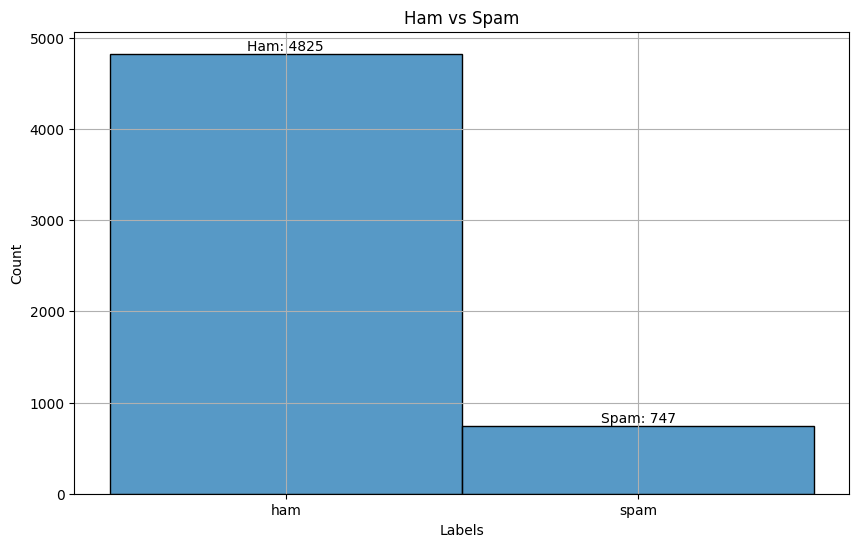

In [103]:
# Histogram using Seaborn to visualize the distribution of labels ('Ham' vs 'Spam')
plot_labels(data['lables'])

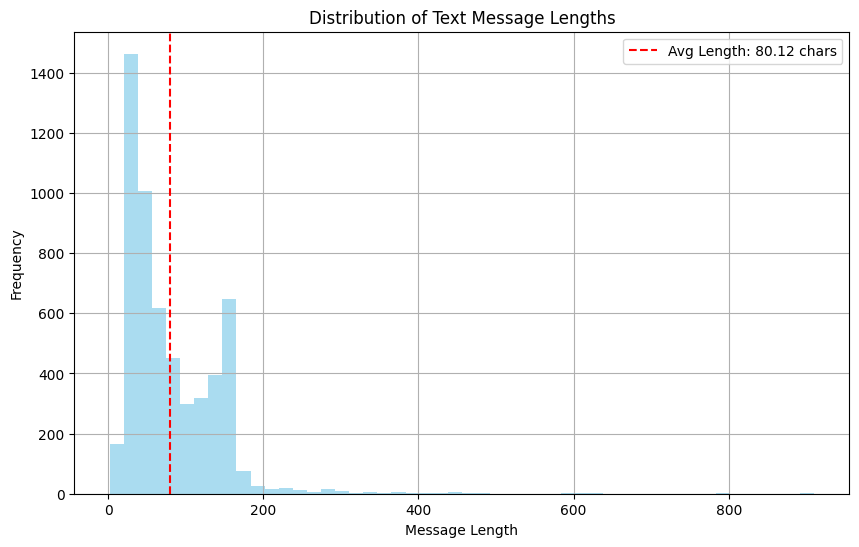

In [104]:
# Create a histogram of text message lengths
plot_message_lengths(data['messages'])

## PorterStemmer

In [105]:
data['clean_text'] = data['messages'].apply(text_preprocessing_stemming) # generates new column and assigns text_preprocessing_stemming function to every text in column 'messages'
data.head() # Display the first five rows of the DataFrame

,lables,messages,clean_text
0,ham,"Go until jurong point, crazy.. Available only ...","go until jurong point, crazy.. available only ..."
1,ham,Ok lar... Joking wif u oni...,ok lar... joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,free entry in 2 a wkly comp to win fa cup fina...
3,ham,U dun say so early hor... U c already then say...,u dun say so early hor... u c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro...","nah i don't think he goes to usf, he lives aro..."


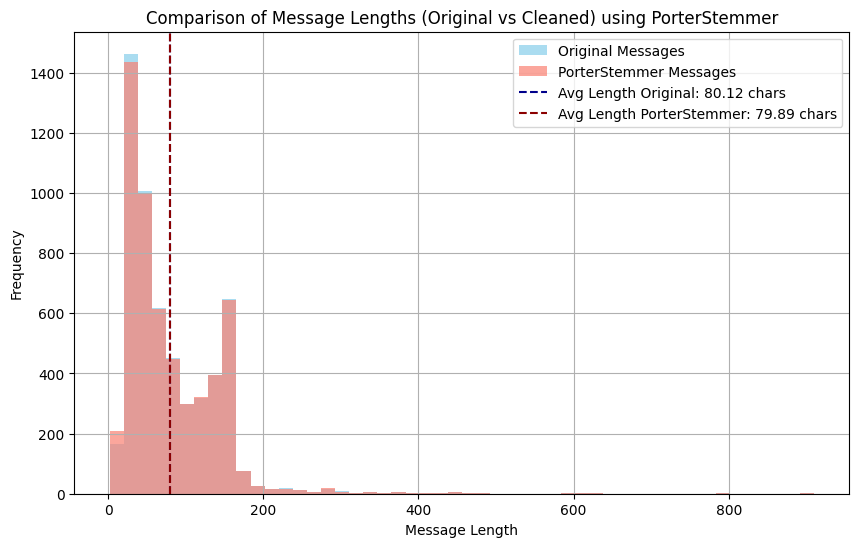

In [106]:
data['original_length'] = data['messages'].apply(len) # Calculate length of original messages
data['cleaned_length'] = data['clean_text'].apply(len) # Calculate length of cleaned messages
plot_message_length(data['original_length'], data['cleaned_length'], 'PorterStemmer') # plot

## WordNetLemmatizer
nearly same as normal messages

In [107]:
data['clean_text'] = data['messages'].apply(text_preprocessing_lemmatization) # generates new column and assigns text_preprocessing_lemmatization function to every text in column 'messages'
data.head() # Display the first five rows of the DataFrame

,lables,messages,clean_text,original_length,cleaned_length
0,ham,"Go until jurong point, crazy.. Available only ...","Go until jurong point, crazy.. Available only ...",111,111
1,ham,Ok lar... Joking wif u oni...,Ok lar... Joking wif u oni...,29,29
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,Free entry in 2 a wkly comp to win FA Cup fina...,155,154
3,ham,U dun say so early hor... U c already then say...,U dun say so early hor... U c already then say...,49,49
4,ham,"Nah I don't think he goes to usf, he lives aro...","Nah I don't think he goes to usf, he lives aro...",61,61


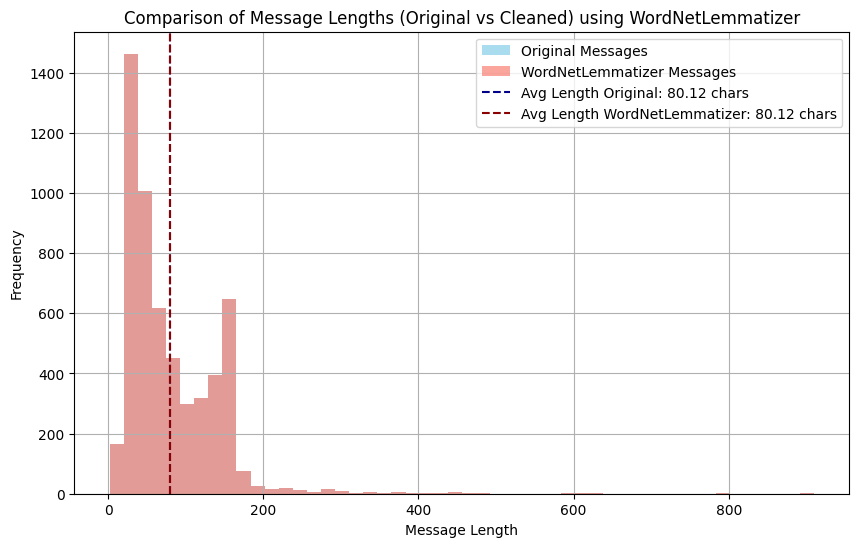

In [108]:
data['original_length'] = data['messages'].apply(len) # Calculate length of original messages
data['cleaned_length'] = data['clean_text'].apply(len) # Calculate length of cleaned messages
plot_message_length(data['original_length'], data['cleaned_length'], 'WordNetLemmatizer') # plot

## Cleaning Text Simple

In [109]:
data['clean_text'] = data['messages'].apply(clean_text) # generates new column and assigns clean_text function to every text in column 'messages'
data.head() # Display the first five rows of the DataFrame

,lables,messages,clean_text,original_length,cleaned_length
0,ham,"Go until jurong point, crazy.. Available only ...",gojurongpointcrazyavailablebugisngreatworldlae...,111,111
1,ham,Ok lar... Joking wif u oni...,oklarjokingwifuoni,29,29
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,freeentry2wklycompwinfacupfinaltkts21stmay2005...,155,155
3,ham,U dun say so early hor... U c already then say...,udunsayearlyhorucalreadysay,49,49
4,ham,"Nah I don't think he goes to usf, he lives aro...",nahthinkgoesusflivesaroundthough,61,61


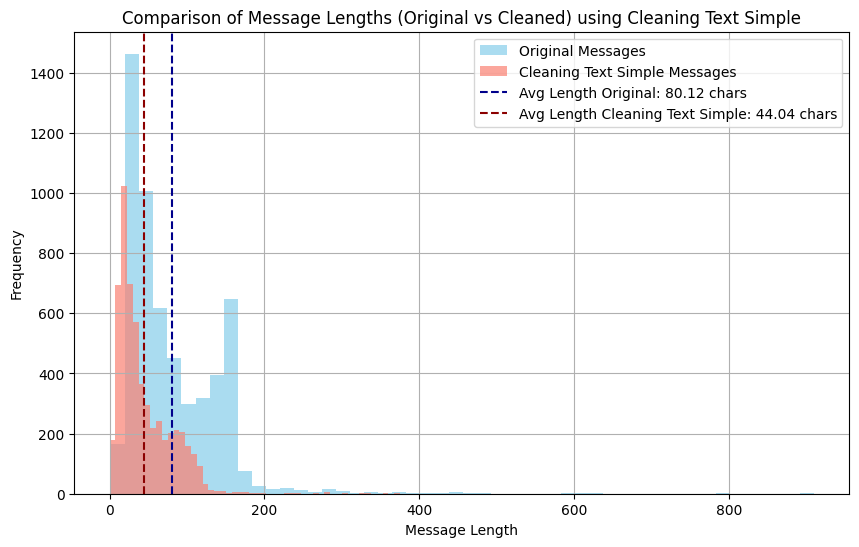

In [110]:
data['original_length'] = data['messages'].apply(len) # Calculate length of original messages
data['cleaned_length'] = data['clean_text'].apply(len) # Calculate length of cleaned messages
plot_message_length(data['original_length'], data['cleaned_length'], 'Cleaning Text Simple') # plot

## Model training PorterStemmer

In [111]:
# generates new column and assigns text_preprocessing_stemming function to every text in column 'messages'
data['clean_text'] = data['messages'].apply(text_preprocessing_stemming)

In [112]:
X = data['clean_text']  # X contains the preprocessed/cleaned text data (features)
y = data['lables'] # y contains the corresponding labels/targets

In [113]:
# Create an empty list to store model evaluation results
model_data = []

Accuracy: 96.5909090909091
              precision    recall  f1-score   support

         ham       0.96      1.00      0.98      1453
        spam       0.99      0.75      0.85       219

    accuracy                           0.97      1672
   macro avg       0.98      0.87      0.92      1672
weighted avg       0.97      0.97      0.96      1672



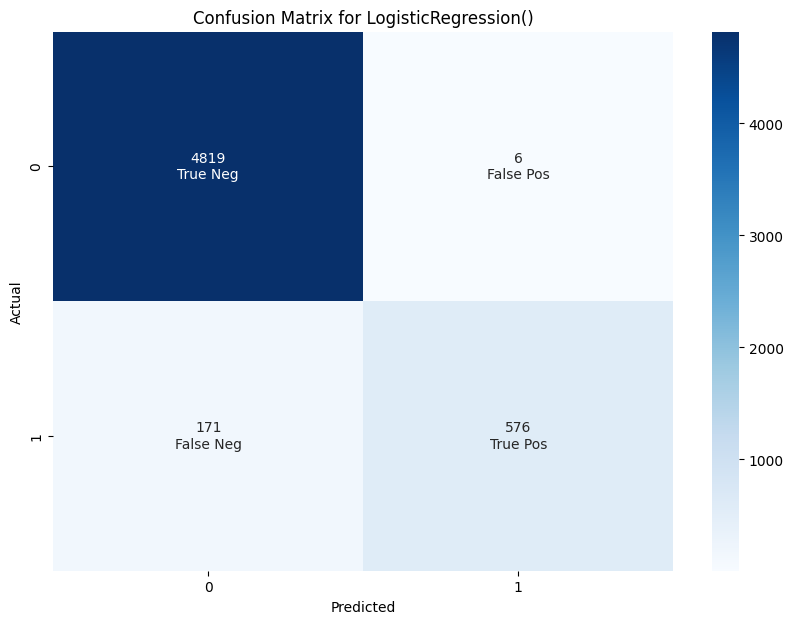

In [114]:
model = LogisticRegression() # Create a Logistic Regression model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(["LogisticRegression",accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 95.99282296650718
              precision    recall  f1-score   support

         ham       0.96      1.00      0.98      1453
        spam       1.00      0.69      0.82       219

    accuracy                           0.96      1672
   macro avg       0.98      0.85      0.90      1672
weighted avg       0.96      0.96      0.96      1672



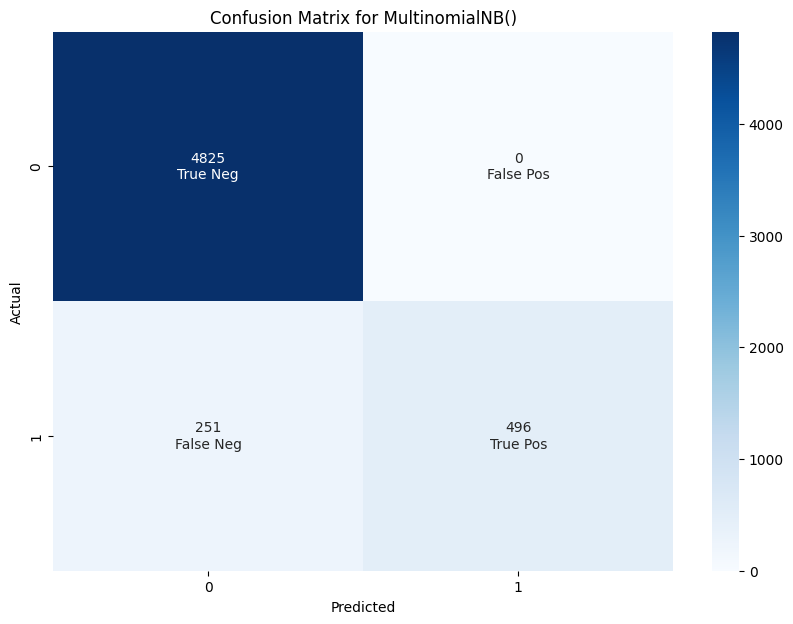

In [115]:
model = MultinomialNB() # Create a Multinomial Naive Bayes model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['MultinomialNB',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 98.08612440191388
              precision    recall  f1-score   support

         ham       0.98      1.00      0.99      1453
        spam       0.99      0.86      0.92       219

    accuracy                           0.98      1672
   macro avg       0.98      0.93      0.96      1672
weighted avg       0.98      0.98      0.98      1672



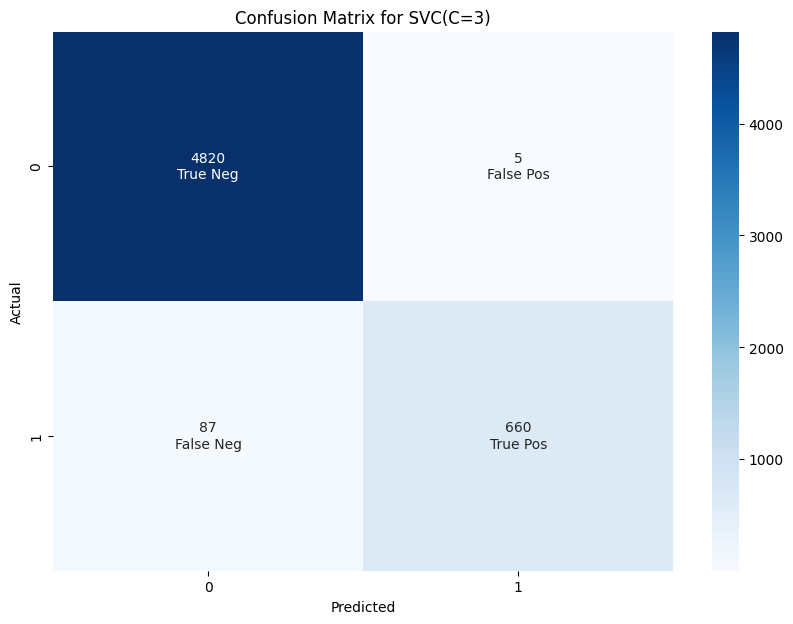

In [116]:
model = SVC(C=3) # Create a Support Vector Classifier (SVC) model instance with C=3
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['SVC',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 97.48803827751196
              precision    recall  f1-score   support

         ham       0.97      1.00      0.99      1453
        spam       0.99      0.81      0.89       219

    accuracy                           0.97      1672
   macro avg       0.98      0.91      0.94      1672
weighted avg       0.98      0.97      0.97      1672



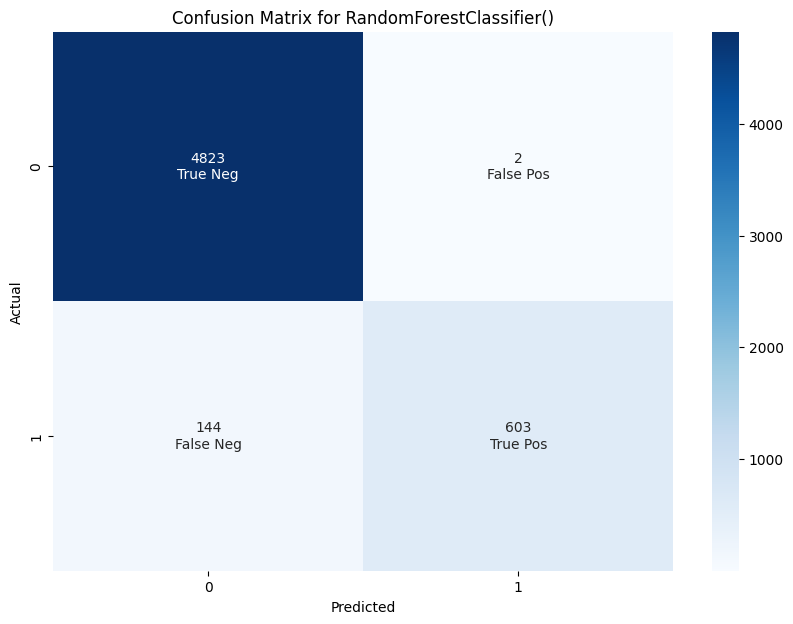

In [117]:
model = RandomForestClassifier() # Create a RandomForestClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['RandomForestClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 96.77033492822966
              precision    recall  f1-score   support

         ham       0.97      1.00      0.98      1453
        spam       0.98      0.77      0.86       219

    accuracy                           0.97      1672
   macro avg       0.97      0.88      0.92      1672
weighted avg       0.97      0.97      0.97      1672



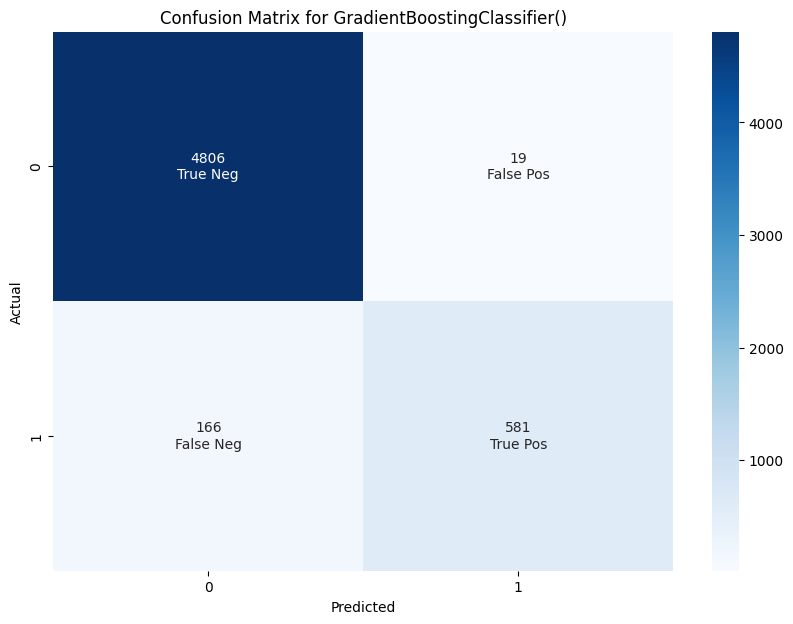

In [118]:
model = GradientBoostingClassifier() # Create a GradientBoostingClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['GradientBoostingClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

In [119]:
accuracy_scores = [row[1] for row in model_data] # Extracting accuracy scores from model_data
f1_scores = [row[2] for row in model_data] # Extracting F1 scores from model_data

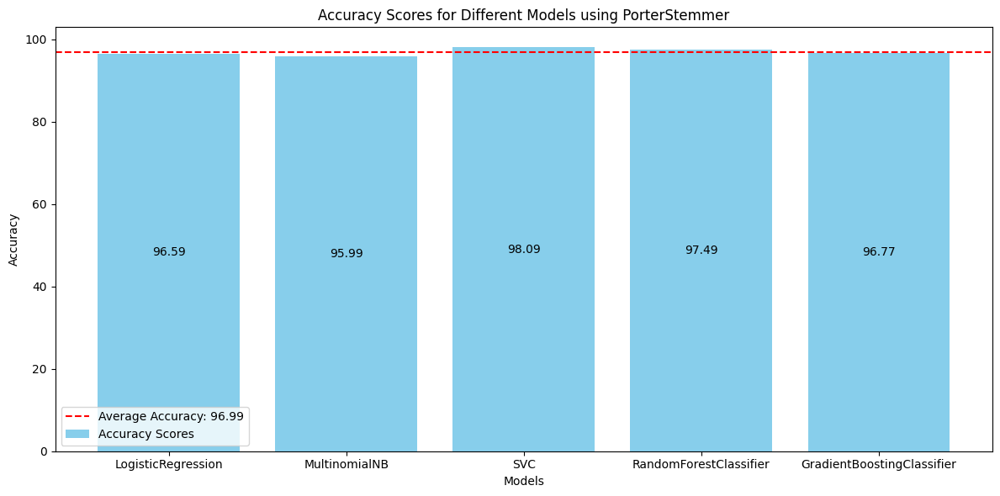

In [120]:
plot_accuracy_scores(accuracy_scores,'PorterStemmer') # plot

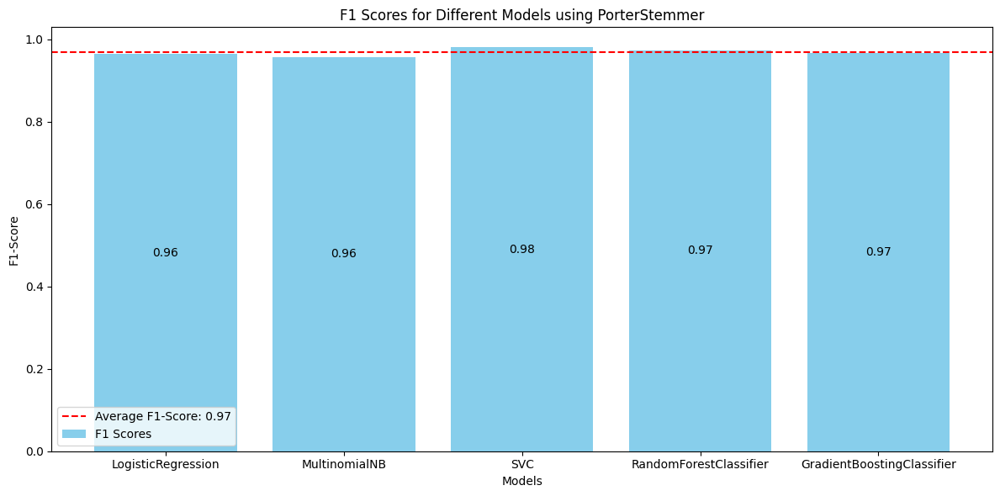

In [121]:
plot_f1_scores(f1_scores, 'PorterStemmer') # plot

## Model training WordNetLemmatizer
nearly same as normal messages

In [122]:
data['clean_text'] = data['messages'].apply(text_preprocessing_lemmatization) # generates new column and assigns clean_text function to every text in column 'messages'

In [123]:
X = data['clean_text']  # X contains the preprocessed/cleaned text data (features)
y = data['lables'] # y contains the corresponding labels/targets

In [124]:
# Create an empty list to store model evaluation results
model_data = []

Accuracy: 96.5909090909091
              precision    recall  f1-score   support

         ham       0.96      1.00      0.98      1453
        spam       0.99      0.74      0.85       219

    accuracy                           0.97      1672
   macro avg       0.98      0.87      0.92      1672
weighted avg       0.97      0.97      0.96      1672



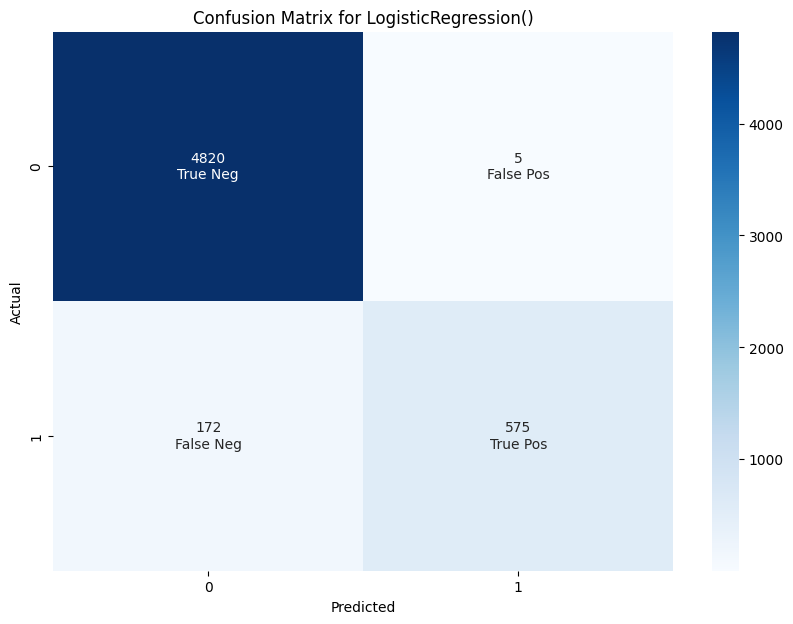

In [125]:
model = LogisticRegression() # Create a Logistic Regression model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(["LogisticRegression",accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 95.99282296650718
              precision    recall  f1-score   support

         ham       0.96      1.00      0.98      1453
        spam       1.00      0.69      0.82       219

    accuracy                           0.96      1672
   macro avg       0.98      0.85      0.90      1672
weighted avg       0.96      0.96      0.96      1672



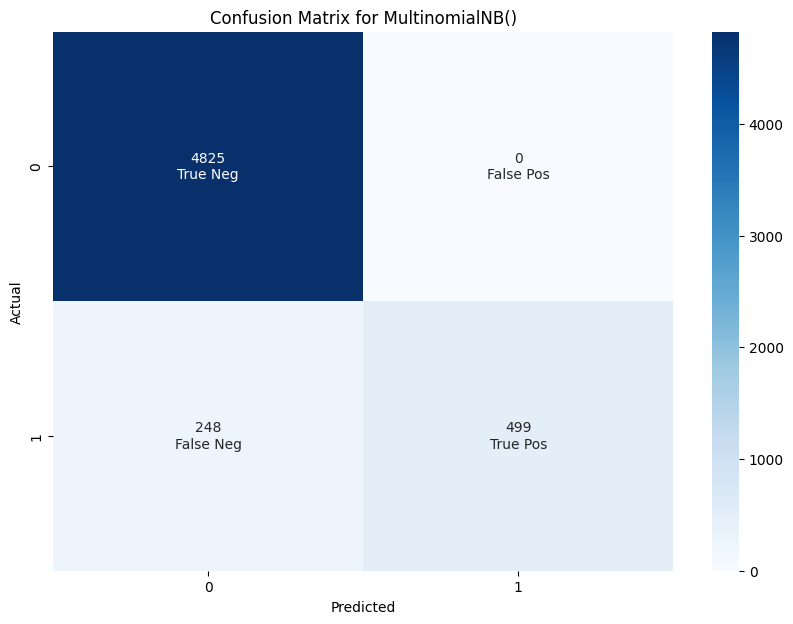

In [126]:
model = MultinomialNB() # Create a Multinomial Naive Bayes model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['MultinomialNB',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 98.14593301435407
              precision    recall  f1-score   support

         ham       0.98      1.00      0.99      1453
        spam       0.99      0.86      0.92       219

    accuracy                           0.98      1672
   macro avg       0.99      0.93      0.96      1672
weighted avg       0.98      0.98      0.98      1672



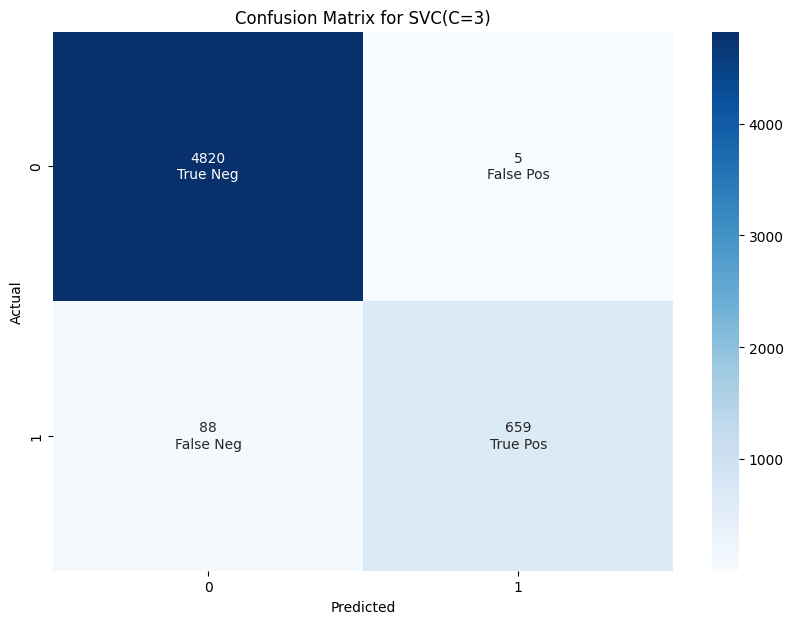

In [127]:
model = SVC(C=3) # Create a Support Vector Classifier (SVC) model instance with C=3
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['SVC',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 97.54784688995215
              precision    recall  f1-score   support

         ham       0.97      1.00      0.99      1453
        spam       1.00      0.81      0.90       219

    accuracy                           0.98      1672
   macro avg       0.99      0.91      0.94      1672
weighted avg       0.98      0.98      0.97      1672



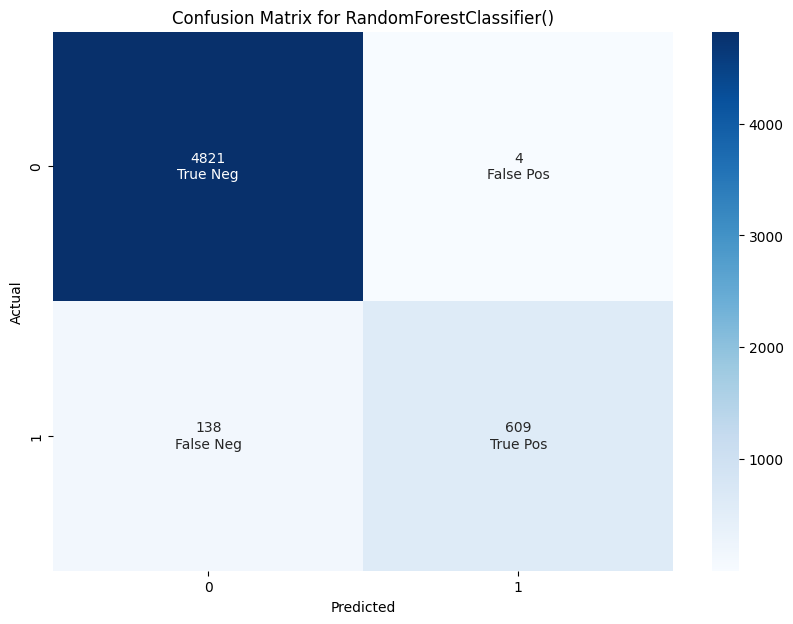

In [128]:
model = RandomForestClassifier() # Create a RandomForestClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['RandomForestClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 96.77033492822966
              precision    recall  f1-score   support

         ham       0.97      1.00      0.98      1453
        spam       0.99      0.76      0.86       219

    accuracy                           0.97      1672
   macro avg       0.98      0.88      0.92      1672
weighted avg       0.97      0.97      0.97      1672



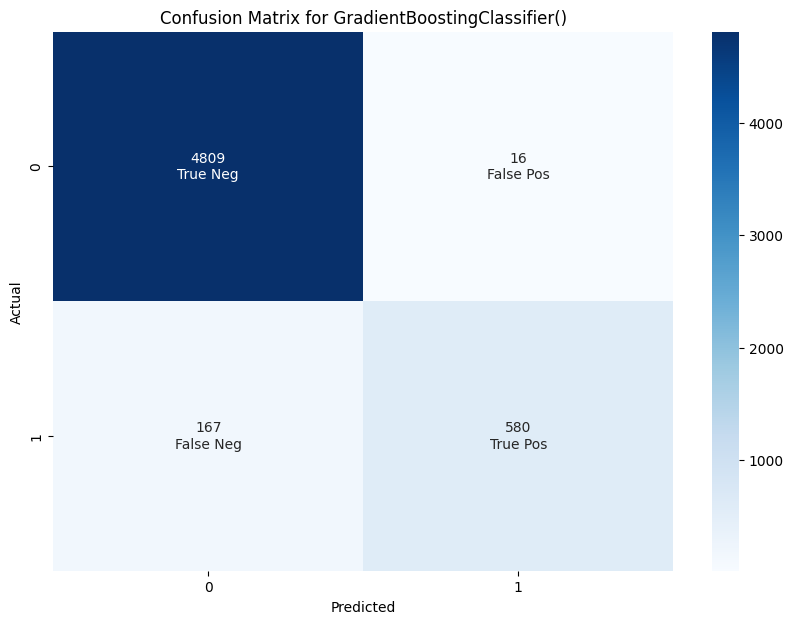

In [129]:
model = GradientBoostingClassifier() # Create a GradientBoostingClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['GradientBoostingClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

In [130]:
accuracy_scores = [row[1] for row in model_data] # Extracting accuracy scores from model_data
f1_scores = [row[2] for row in model_data] # Extracting F1 scores from model_data

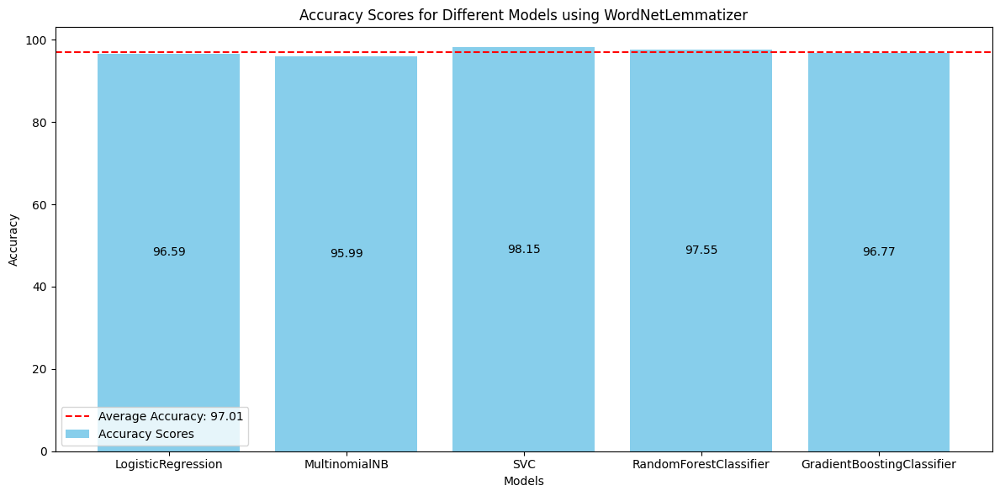

In [131]:
plot_accuracy_scores(accuracy_scores, 'WordNetLemmatizer') # plot

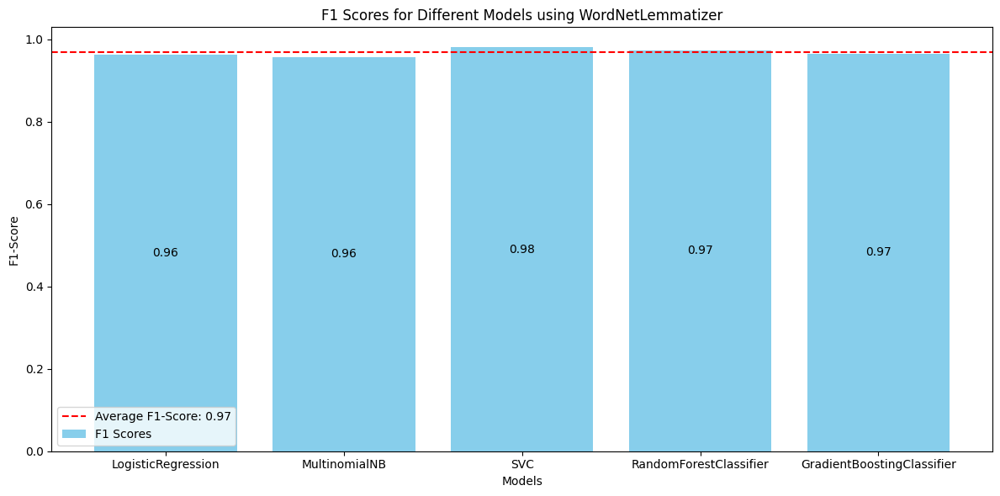

In [132]:
plot_f1_scores(f1_scores, 'WordNetLemmatizer') # plot

## Model training cleaning text simple

In [133]:
data['clean_text'] = data['messages'].apply(clean_text) # generates new column and assigns clean_text function to every text in column 'messages'

In [134]:
X = data['clean_text']  # X contains the preprocessed/cleaned text data (features)
y = data['lables'] # y contains the corresponding labels/targets

In [135]:
# Create an empty list to store model evaluation results
model_data = []

Accuracy: 86.9019138755981


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

         ham       0.87      1.00      0.93      1453
        spam       0.00      0.00      0.00       219

    accuracy                           0.87      1672
   macro avg       0.43      0.50      0.46      1672
weighted avg       0.76      0.87      0.81      1672



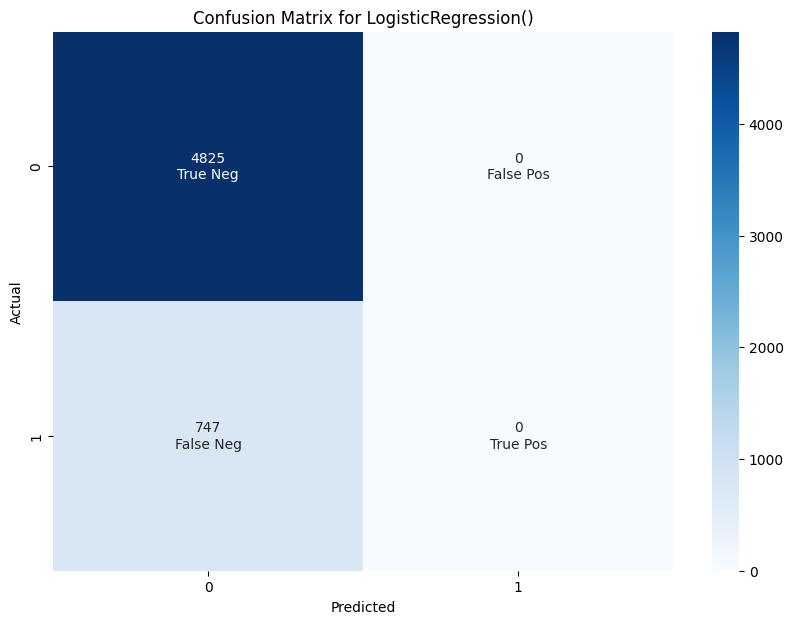

In [136]:
model = LogisticRegression() # Create a Logistic Regression model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(["LogisticRegression",accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 86.96172248803828
              precision    recall  f1-score   support

         ham       0.87      1.00      0.93      1453
        spam       1.00      0.00      0.01       219

    accuracy                           0.87      1672
   macro avg       0.93      0.50      0.47      1672
weighted avg       0.89      0.87      0.81      1672



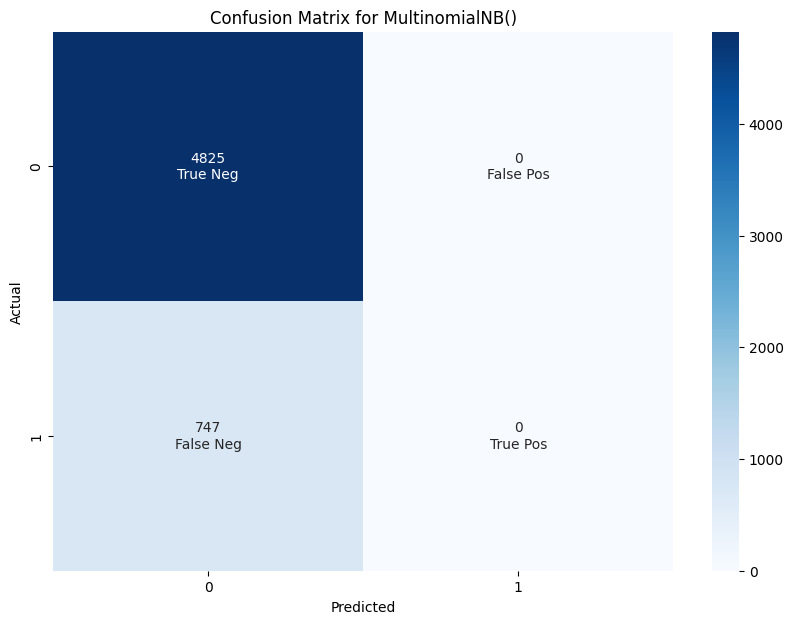

In [137]:
model = MultinomialNB() # Create a Multinomial Naive Bayes model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['MultinomialNB',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 90.19138755980862
              precision    recall  f1-score   support

         ham       0.90      1.00      0.95      1453
        spam       1.00      0.25      0.40       219

    accuracy                           0.90      1672
   macro avg       0.95      0.63      0.67      1672
weighted avg       0.91      0.90      0.88      1672



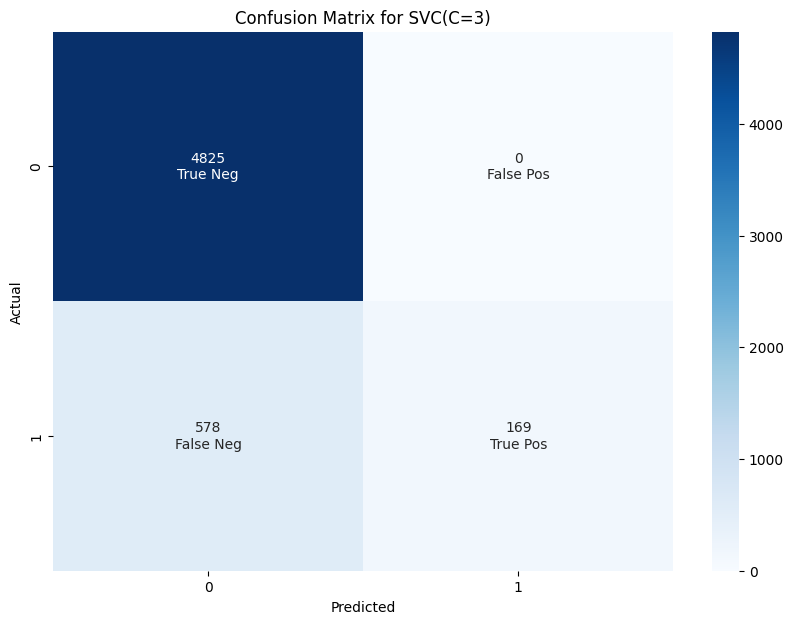

In [138]:
model = SVC(C=3) # Create a Support Vector Classifier (SVC) model instance with C=3
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['SVC',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 90.19138755980862
              precision    recall  f1-score   support

         ham       0.90      1.00      0.95      1453
        spam       1.00      0.25      0.40       219

    accuracy                           0.90      1672
   macro avg       0.95      0.63      0.67      1672
weighted avg       0.91      0.90      0.88      1672



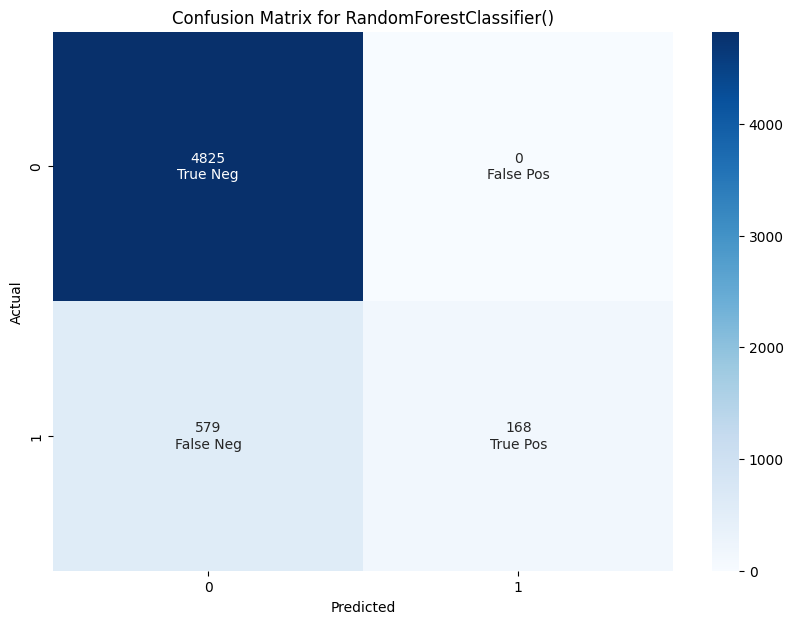

In [139]:
model = RandomForestClassifier() # Create a RandomForestClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['RandomForestClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 86.9019138755981


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

         ham       0.87      1.00      0.93      1453
        spam       0.00      0.00      0.00       219

    accuracy                           0.87      1672
   macro avg       0.43      0.50      0.46      1672
weighted avg       0.76      0.87      0.81      1672



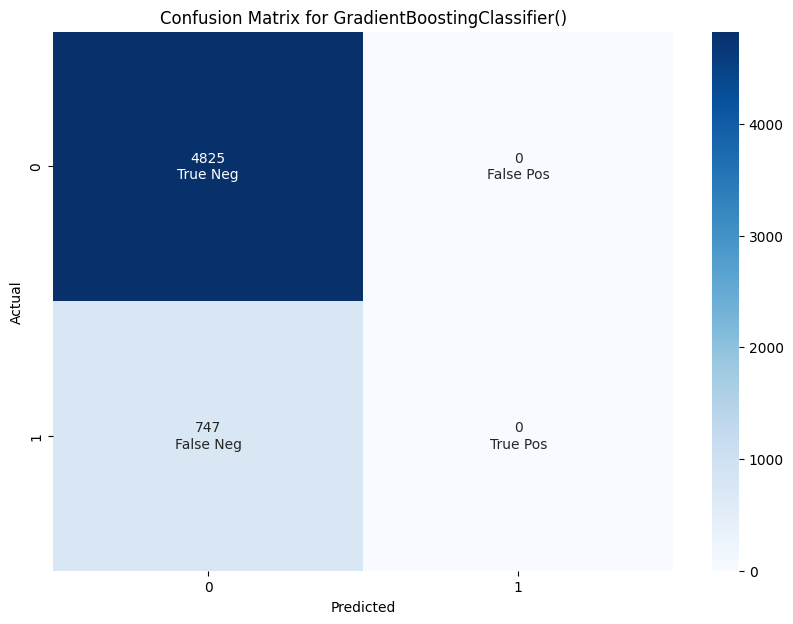

In [140]:
model = GradientBoostingClassifier() # Create a GradientBoostingClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['GradientBoostingClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

In [141]:
accuracy_scores = [row[1] for row in model_data] # Extracting accuracy scores from model_data
f1_scores = [row[2] for row in model_data] # Extracting F1 scores from model_data

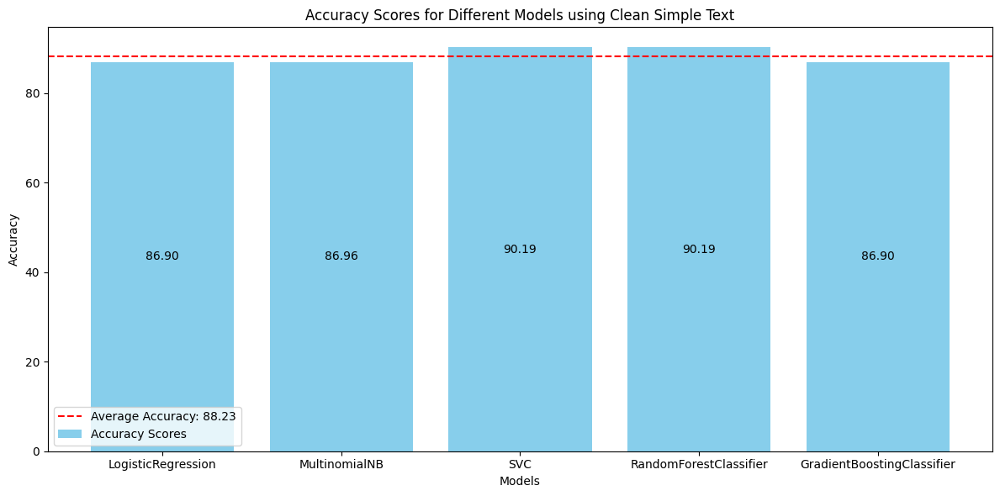

In [142]:
plot_accuracy_scores(accuracy_scores, 'Clean Simple Text') #plot

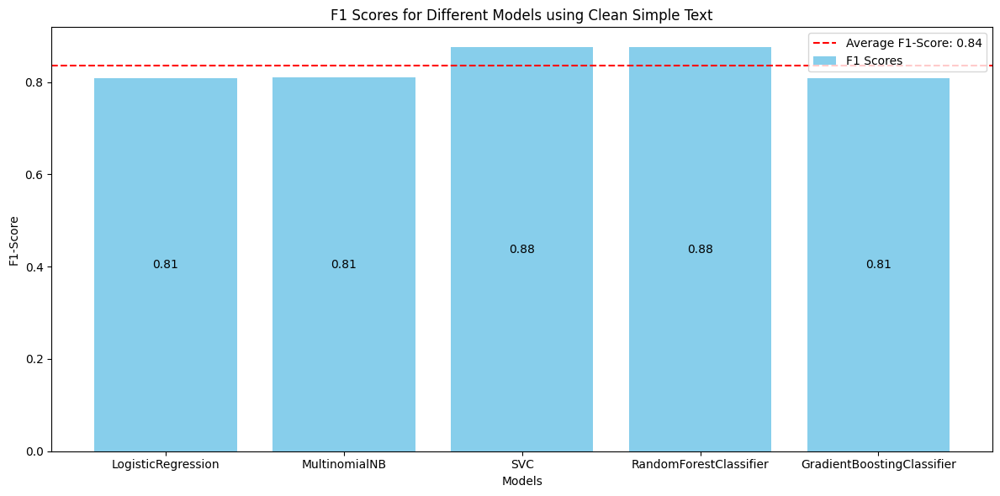

In [143]:
plot_f1_scores(f1_scores, 'Clean Simple Text') #plot

## No Preprocessing

In [144]:
X = data['messages']  # X contains the text data (features)
y = data['lables'] # y contains the corresponding labels/targets

In [145]:
# Create an empty list to store model evaluation results
model_data = []

Accuracy: 96.5909090909091
              precision    recall  f1-score   support

         ham       0.96      1.00      0.98      1453
        spam       0.99      0.74      0.85       219

    accuracy                           0.97      1672
   macro avg       0.98      0.87      0.92      1672
weighted avg       0.97      0.97      0.96      1672



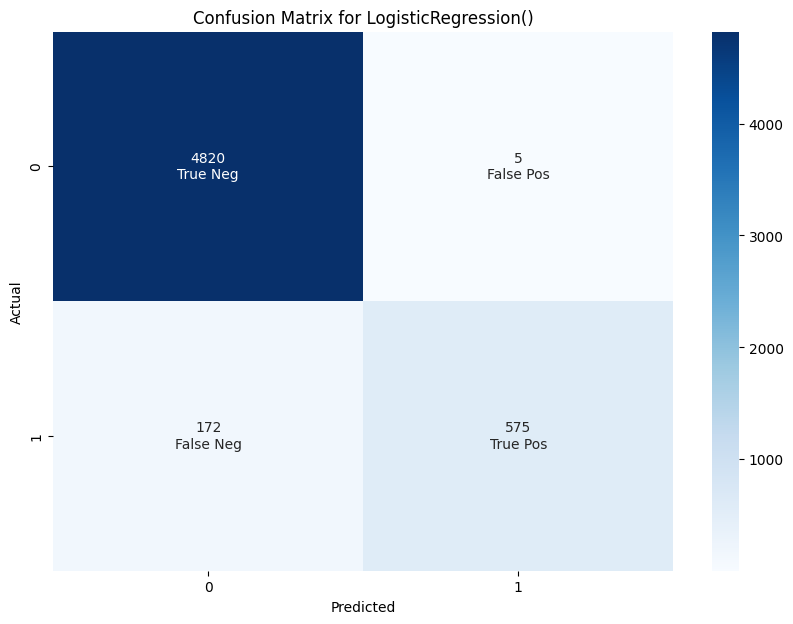

In [146]:
model = LogisticRegression() # Create a Logistic Regression model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(["LogisticRegression",accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 95.99282296650718
              precision    recall  f1-score   support

         ham       0.96      1.00      0.98      1453
        spam       1.00      0.69      0.82       219

    accuracy                           0.96      1672
   macro avg       0.98      0.85      0.90      1672
weighted avg       0.96      0.96      0.96      1672



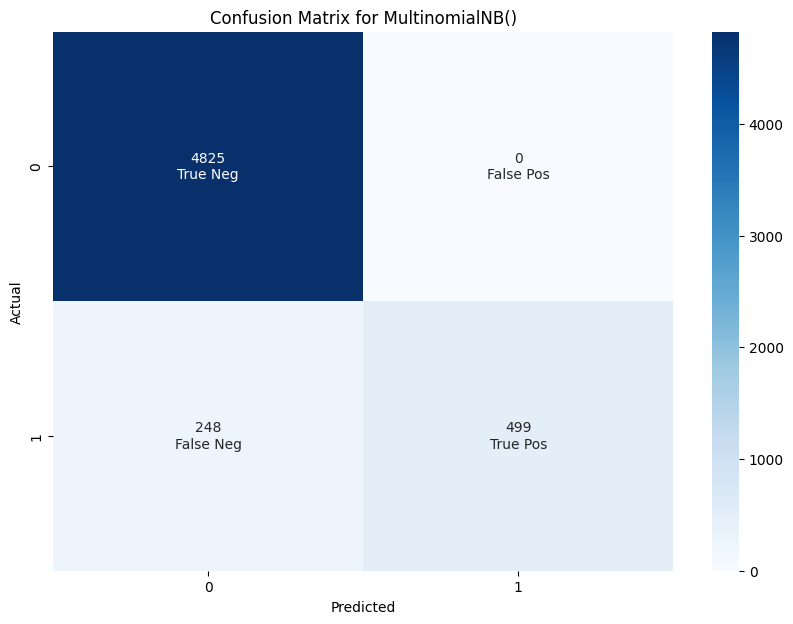

In [147]:
model = MultinomialNB() # Create a Multinomial Naive Bayes model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['MultinomialNB',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 98.14593301435407
              precision    recall  f1-score   support

         ham       0.98      1.00      0.99      1453
        spam       0.99      0.86      0.92       219

    accuracy                           0.98      1672
   macro avg       0.99      0.93      0.96      1672
weighted avg       0.98      0.98      0.98      1672



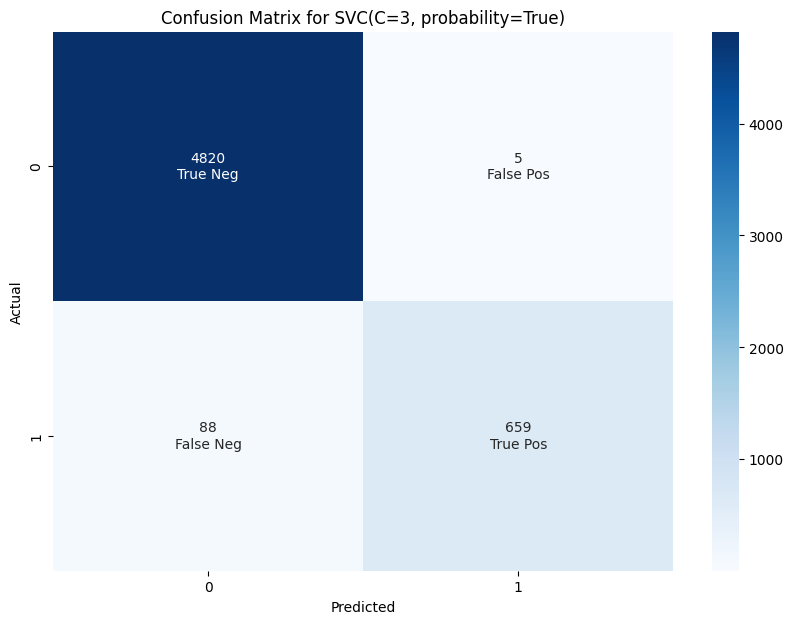

In [148]:
model = SVC(C=3, probability=True) # Create a Support Vector Classifier (SVC) model instance with C=3
accuracy, f1_weighted, best_clf = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['SVC',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 97.72727272727273
              precision    recall  f1-score   support

         ham       0.97      1.00      0.99      1453
        spam       1.00      0.83      0.91       219

    accuracy                           0.98      1672
   macro avg       0.99      0.91      0.95      1672
weighted avg       0.98      0.98      0.98      1672



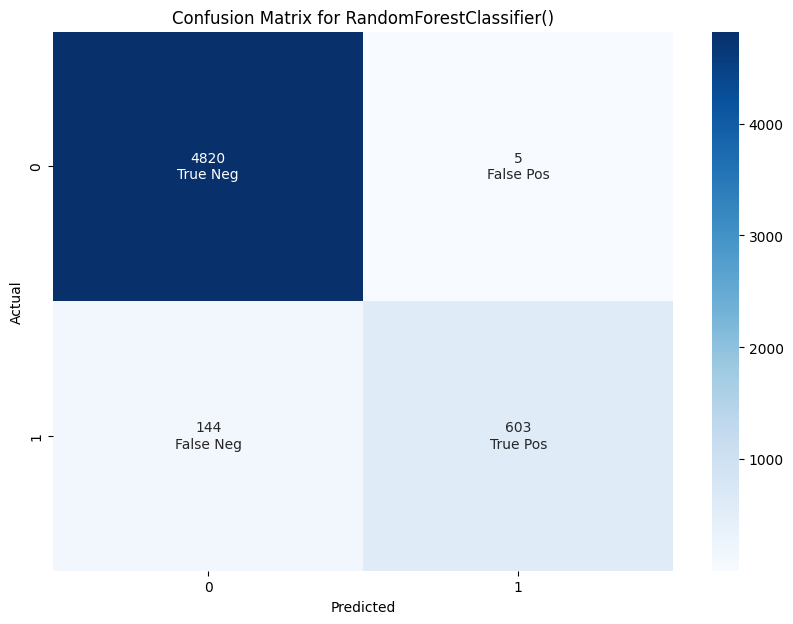

In [149]:
model = RandomForestClassifier() # Create a RandomForestClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['RandomForestClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

Accuracy: 96.77033492822966
              precision    recall  f1-score   support

         ham       0.97      1.00      0.98      1453
        spam       0.99      0.76      0.86       219

    accuracy                           0.97      1672
   macro avg       0.98      0.88      0.92      1672
weighted avg       0.97      0.97      0.97      1672



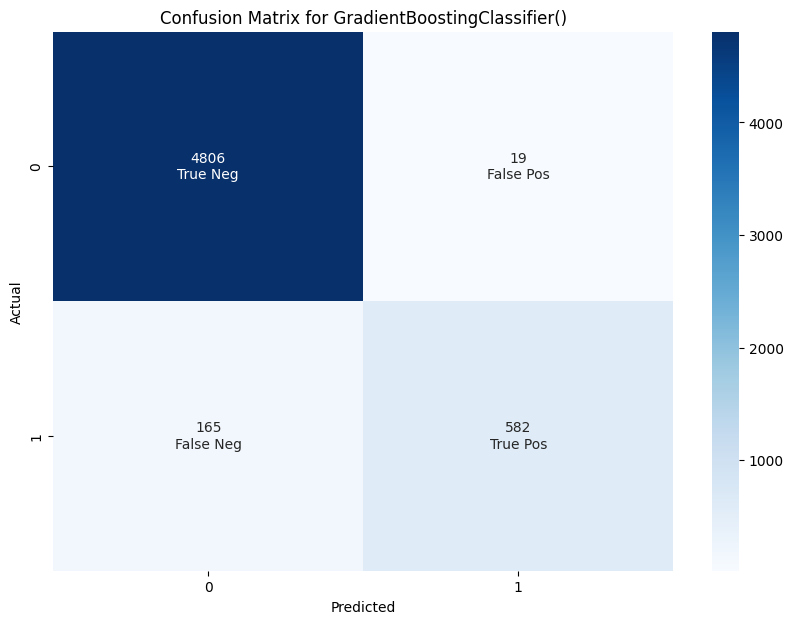

In [150]:
model = GradientBoostingClassifier() # Create a GradientBoostingClassifier model instance
accuracy, f1_weighted, _ = classify(model, X, y) # Train the model using the classify function and obtain accuracy and weighted F1-score
model_data.append(['GradientBoostingClassifier',accuracy, f1_weighted]) # Append model name along with accuracy and F1-score to the model_data list

In [151]:
accuracy_scores = [row[1] for row in model_data] # Extracting accuracy scores from model_data
f1_scores = [row[2] for row in model_data] # Extracting F1 scores from model_data

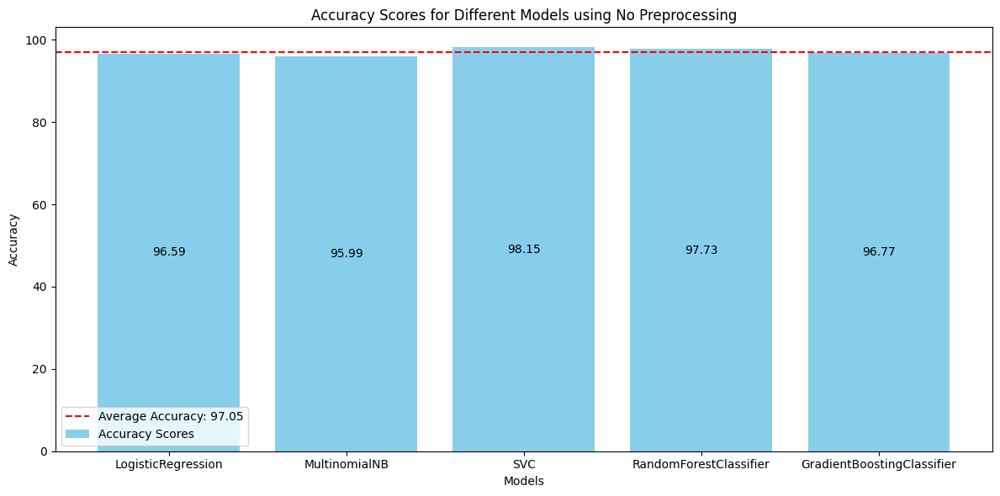

In [152]:
plot_accuracy_scores(accuracy_scores, 'No Preprocessing') # plot

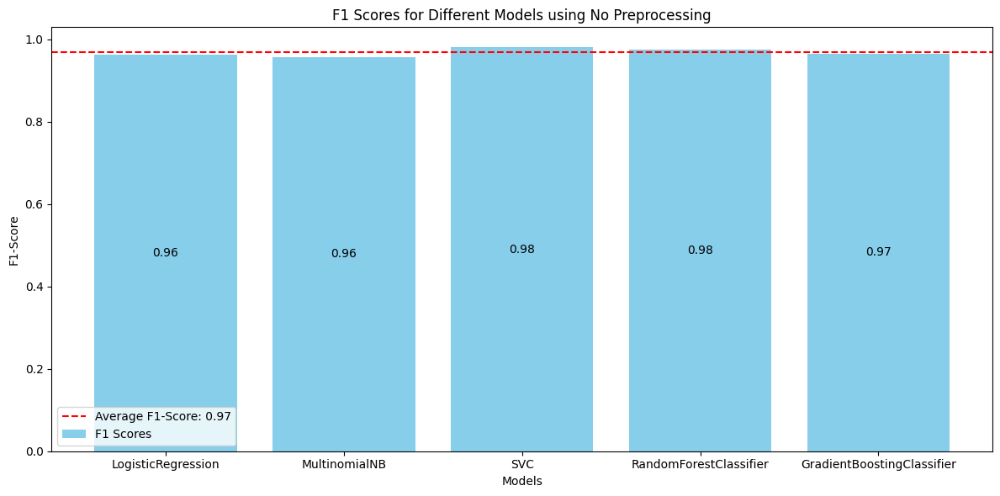

In [153]:
plot_f1_scores(f1_scores, 'No Preprocessing') # plot

## LIME

In [154]:
explainer = LimeTextExplainer(class_names=['ham', 'spam']) # Create a Lime Text Explainer and pass the Values of the labels

idx = 0 # Define the Index of the Element that should be analyzed
exp = explainer.explain_instance(X[idx], best_clf.predict_proba, num_features=6) # Call the Function to explain the Sample
print('Entry id: %d' % idx) # Print the ID of the Entry
print('True class: %s' % y[idx]) # Print the True Class of the Entry
exp.show_in_notebook(text=True) # Plot the results from LIME

Entry id: 0
True class: ham


In [155]:
idx = [2, 5, 1773, 2134, 2385, 4212, 4677, 2018, 1877, 807] # Creating a list width randomly chosen Samples

for i in idx: # looping throw the list and print the results of each sample
  exp = explainer.explain_instance(X[i], best_clf.predict_proba, num_features=6) # Call the Function to explain the Sample
  print('Entry id: %d' % i) # Print the ID of the Entry
  print('True class: %s' % y[i]) # Print the True Class of the Entry
  exp.show_in_notebook(text=True) # Plot the results from LIME

Entry id: 2
True class: spam


Entry id: 5
True class: spam


Entry id: 1773
True class: ham


Entry id: 2134
True class: ham


Entry id: 2385
True class: spam


Entry id: 4212
True class: ham


Entry id: 4677
True class: ham


Entry id: 2018
True class: ham


Entry id: 1877
True class: ham


Entry id: 807
True class: ham


## requirements.txt

In [156]:
pip freeze > requirements.txt

## Discussion & Conclusion
According to the performance measurement, the best preprocessing methods are WordNertLemmentazier/No Preprocessing together with Support Vector classifier model.

Text preprocessing can make a huge difference depending on the data and use-case. In our case preprocessing has no impact or made it worse.

In some cases, the trained model has high score values but the confusion matrix shows that the model does not detect spam messages. The reason for that is that the dataset is unbalanced. In the dataset there are 87% ham messages and only 13% are spam messages.

According to the analysis made width LIME the words that indicate ham and spam are the following:

**ham**
- good
- he
- but
- thing
- not
- it
- do
- want

**spam**
- now
- to
- service
- call
- over
- free
- win
- until

